<img src="https://data.atoti.io/notebooks/covid-analytics/img/banner.jpg">

# Atoti Introductory Course - Covid-19 Data Analysis
\[_In case you’re unable to see the Atoti visualizations in GitHub, try viewing the notebook in [nbviewer](https://nbviewer.org/github/atoti/atoti/blob/main/03-use-cases/02-other-industries/global-covid-data/main.ipynb#atoti-Introductory-Course---Covid-19-Data-Analysis)._]

Last tested version: <img src="https://img.shields.io/badge/Atoti-v0.8.4-blue">

## Objective

This notebook is an introductory guide to **Atoti**. With a minimum amount of coding, we will build the dashboard seen in the following GIF.  

<img src="https://data.atoti.io/notebooks/covid-analytics/img/introductory_course_060.gif">

This course is suitable for analysts with basic Python knowledge.

<div style="text-align: center;" ><a href="https://www.atoti.io/?utm_source=gallery&utm_content=global-covid-data" target="_blank" rel="noopener noreferrer"><img src="https://data.atoti.io/notebooks/banners/Discover-Atoti-now.png" alt="Try Atoti"></a></div>

# Overview

We will be exploring how to use **Atoti** via an exploration of [Our World in Data's Covid Data](https://ourworldindata.org/coronavirus), available from their [git repository](https://github.com/owid/covid-19-data/tree/master/public/data).

### This guide will cover the following:
* Getting started
* Organizing data
* Exploring data with Atoti's pivot table
* Creating new measures
* Saving and applying filters
* Adding a new data source
* Dashboarding

### What it won't cover:

[How to install Atoti](https://docs.atoti.io/latest/installation.html)

# Getting Started  

Refer to [Atoti's tutorial](https://docs.atoti.io/latest/tutorial/tutorial.html#Getting-started) for more examples on how to get started.  
Or check out the other notebooks in our [notebook gallery](https://github.com/atoti/notebooks/tree/master/notebooks).

### Loading libraries

In [1]:
import atoti as tt

### Beginning a session

We can immediately dive into creating a session, where we have an option to set up our session name and [configurations](https://docs.atoti.io/latest/lib/atoti.config.session_config.html#atoti.config.session_config.SessionConfig).  We'll define a location to store our dashboarding metadata and set our port so our dashboard will be available from the same fixed port.

In [2]:
session = tt.Session(user_content_storage="./content", port=9090)

__Atoti__ can read in different types of data sources. Other than standard sources like a CSV, it can read Pandas dataframes, Sparks dataframes, Numpy ndarrays, [and others](https://www.atoti.io/features/).

When reading a CSV source, Atoti infers the data type of the columns from the first 1,000 lines unless specified.  
We can specify the types as follows:
```
    types={
        "excess_mortality": tt.type.DOUBLE,
        "extreme_poverty": tt.type.DOUBLE,
    }
```
Since we have multiple columns where we would like to explicitly cast to a *DOUBLE*, we use a loop to cast the type instead.

In [3]:
covid_data = session.read_csv(
    "s3://data.atoti.io/notebooks/covid-analytics/owid-covid-data-as-of-20210810.csv",
    keys=["iso_code", "date"],
    table_name="covid_stats",
    types={
        t: tt.type.DOUBLE
        for t in [
            "excess_mortality",
            "extreme_poverty",
            "female_smokers",
            "hosp_patients",
            "hosp_patients_per_million",
            "icu_patients",
            "icu_patients_per_million",
            "male_smokers",
            "new_tests",
            "new_tests_per_thousand",
            "weekly_hosp_admissions",
            "weekly_hosp_admissions_per_million",
            "weekly_icu_admissions",
            "weekly_icu_admissions_per_million",
            "new_tests_smoothed",
            "new_tests_smoothed_per_thousand",
            "positive_rate",
            "tests_per_case",
            "total_tests",
            "total_tests_per_thousand",
        ]
    },
)

In [4]:
covid_data.head()

continent location  total_cases  new_cases  \
iso_code date                                                    
DZA      2020-12-11    Africa  Algeria      91121.0      542.0   
OWID_AFR 2021-03-23       N/A   Africa    4124688.0     8586.0   
ALB      2021-01-28    Europe  Albania      75454.0      887.0   
OWID_AFR 2021-03-29       N/A   Africa    4194799.0     9707.0   
         2021-03-30       N/A   Africa    4204561.0     9762.0   

                     new_cases_smoothed  total_deaths  new_deaths  \
iso_code date                                                       
DZA      2020-12-11             627.286        2575.0        11.0   
OWID_AFR 2021-03-23           10226.429      110485.0       322.0   
ALB      2021-01-28             791.143        1350.0        11.0   
OWID_AFR 2021-03-29           11242.429      112225.0       312.0   
         2021-03-30           11410.429      112502.0       277.0   

                     new_deaths_smoothed  total_cases_per_million  \
iso_code date                                                       
DZA      2020-12-11               11.857                 2077.967   
OWID_AFR 2021-03-23              298.714                 3076.752   
ALB      2021-01-28                7.714                26219.334   
OWID_AFR 2021-03-29              294.571                  3129.05   
         2021-03-30              288.143                 3136.332   

                     new_cases_per_million  ...  extreme_poverty  \
iso_code date                               ...                    
DZA      2020-12-11                  12.36  ...              0.5   
OWID_AFR 2021-03-23                  6.405  ...             <NA>   
ALB      2021-01-28                308.222  ...              1.1   
OWID_AFR 2021-03-29                  7.241  ...             <NA>   
         2021-03-30                  7.282  ...             <NA>   

                     cardiovasc_death_rate  diabetes_prevalence  \
iso_code date                                                     
DZA      2020-12-11                278.364                 6.73   
OWID_AFR 2021-03-23                   <NA>                 <NA>   
ALB      2021-01-28                304.195                10.08   
OWID_AFR 2021-03-29                   <NA>                 <NA>   
         2021-03-30                   <NA>                 <NA>   

                     female_smokers  male_smokers  handwashing_facilities  \
iso_code date                                                               
DZA      2020-12-11             0.7          30.4                  83.741   
OWID_AFR 2021-03-23            <NA>          <NA>                    <NA>   
ALB      2021-01-28             7.1          51.2                    <NA>   
OWID_AFR 2021-03-29            <NA>          <NA>                    <NA>   
         2021-03-30            <NA>          <NA>                    <NA>   

                     hospital_beds_per_thousand  life_expectancy  \
iso_code date                                                      
DZA      2020-12-11                         1.9            76.88   
OWID_AFR 2021-03-23                        <NA>             <NA>   
ALB      2021-01-28                        2.89            78.57   
OWID_AFR 2021-03-29                        <NA>             <NA>   
         2021-03-30                        <NA>             <NA>   

                     human_development_index  excess_mortality  
iso_code date                                                   
DZA      2020-12-11                    0.748              <NA>  
OWID_AFR 2021-03-23                     <NA>              <NA>  
ALB      2021-01-28                    0.795              <NA>  
OWID_AFR 2021-03-29                     <NA>              <NA>  
         2021-03-30                     <NA>              <NA>  

[5 rows x 58 columns]

Take a look at the shape of data loaded into table.

In [5]:
{"columns": len(covid_data.columns), "rows": len(covid_data)}

{'columns': 60, 'rows': 108461}

We are now ready to create our cube. 


💡 __Tip__: We can define the [mode for cube creation](https://docs.atoti.io/latest/lib/atoti.session.html#atoti.session.Session.create_cube). They include: 
- auto: Creates hierarchies for every key or non-numeric column of the table, and measures for every numeric column.
- manual: Does not create any hierarchy or measure (except for count).
- no_measures: Creates hierarchies like auto but does not create any measures.  

If no mode is specified, it will default to auto.  
Note: if a table has *hierarchized_columns* defined, only those defined columns will be converted into hierarchies regardless of the cube creation mode.

We'll be using auto mode with no hierarchized columns defined.

In [6]:
cube = session.create_cube(covid_data, "covid")

In [7]:
cube

# Organizing data

We can access the cube's attributes via `cube.hierarchies`, `cube.levels` and `cube.measures`. We can also simplify how we access our measures and hierarchies by assigning aliases. 

In [8]:
h, l, m = cube.hierarchies, cube.levels, cube.measures

In [9]:
m

{'contributors.COUNT': <atoti.measure.Measure object at 0x0000022ECDF27940>, 'update.TIMESTAMP': <atoti.measure.Measure object at 0x0000022ECDF7D150>, 'gdp_per_capita.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D1B0>, 'gdp_per_capita.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D180>, 'new_vaccinations_smoothed_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D1E0>, 'new_vaccinations_smoothed_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D240>, 'tests_per_case.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D270>, 'tests_per_case.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D2A0>, 'stringency_index.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D2D0>, 'stringency_index.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D300>, 'people_fully_vaccinated.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D330>, 'people_fully_vaccinated.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D360>, 'hosp_patients_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D390>, 'hosp_patients_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D3C0>, 'new_tests_smoothed.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D3F0>, 'new_tests_smoothed.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D420>, 'weekly_icu_admissions_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D450>, 'weekly_icu_admissions_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D480>, 'total_deaths_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D4B0>, 'total_deaths_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D4E0>, 'icu_patients_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D510>, 'icu_patients_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D540>, 'new_vaccinations_smoothed.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D570>, 'new_vaccinations_smoothed.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D5A0>, 'total_cases.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D5D0>, 'total_cases.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D600>, 'new_cases_smoothed.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D630>, 'new_cases_smoothed.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D660>, 'diabetes_prevalence.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D690>, 'diabetes_prevalence.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D6C0>, 'new_deaths_smoothed_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D6F0>, 'new_deaths_smoothed_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D720>, 'people_vaccinated.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D750>, 'people_vaccinated.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D780>, 'hosp_patients.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D7B0>, 'hosp_patients.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D7E0>, 'total_vaccinations.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D810>, 'total_vaccinations.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D840>, 'reproduction_rate.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D870>, 'reproduction_rate.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D8A0>, 'cardiovasc_death_rate.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D8D0>, 'cardiovasc_death_rate.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D900>, 'life_expectancy.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D930>, 'life_expectancy.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D960>, 'new_deaths_smoothed.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D990>, 'new_deaths_smoothed.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7D9C0>, 'icu_patients.SUM': <atoti.measure.Measure object at 0x0000022ECDF7D9F0>, 'icu_patients.MEAN': <atoti.measure.Measure object at 0x0000022ECDF7DA20>, 'population_density.SUM': <atoti.measure.Measu

💡 __Tip__: There are many ways we can [clean up measures](https://docs.atoti.io/latest/tutorial/tutorial.html#Polishing-the-cube).  
- We can put a measure into a folder by setting `m["measure name"].folder = "folder name"`.  
- We can hide measures from users by setting `m["measure name"].visible = False`. These could be technical measures used for interim computation.
- We can delete unused measures with `del m["measure name"]`.

### Creating measure folders

In [10]:
for measure in [
    m["icu_patients.MEAN"],
    m["icu_patients.SUM"],
    m["icu_patients_per_million.MEAN"],
    m["icu_patients_per_million.SUM"],
]:
    measure.folder = "Hospital Stats"

In [11]:
m

{'contributors.COUNT': <atoti.measure.Measure object at 0x0000022ECDF7F070>, 'update.TIMESTAMP': <atoti.measure.Measure object at 0x0000022ECDF0D2D0>, 'gdp_per_capita.SUM': <atoti.measure.Measure object at 0x0000022ECDF0D1E0>, 'gdp_per_capita.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0D2A0>, 'new_vaccinations_smoothed_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDF0D210>, 'new_vaccinations_smoothed_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0D1B0>, 'tests_per_case.SUM': <atoti.measure.Measure object at 0x0000022ECDF0D150>, 'tests_per_case.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0D120>, 'stringency_index.SUM': <atoti.measure.Measure object at 0x0000022ECDF0D060>, 'stringency_index.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0D090>, 'people_fully_vaccinated.SUM': <atoti.measure.Measure object at 0x0000022ECDF0D000>, 'people_fully_vaccinated.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0D030>, 'hosp_patients_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDF0CFD0>, 'hosp_patients_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0CFA0>, 'new_tests_smoothed.SUM': <atoti.measure.Measure object at 0x0000022ECDF0CEE0>, 'new_tests_smoothed.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0CF10>, 'weekly_icu_admissions_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDF0CE80>, 'weekly_icu_admissions_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0CEB0>, 'total_deaths_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDF0CE50>, 'total_deaths_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0CE20>, 'icu_patients_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDF0CD60>, 'icu_patients_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0CD90>, 'new_vaccinations_smoothed.SUM': <atoti.measure.Measure object at 0x0000022ECDF0CD00>, 'new_vaccinations_smoothed.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0CD30>, 'total_cases.SUM': <atoti.measure.Measure object at 0x0000022ECDF0CCD0>, 'total_cases.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0CCA0>, 'new_cases_smoothed.SUM': <atoti.measure.Measure object at 0x0000022ECDF0CBE0>, 'new_cases_smoothed.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0CC10>, 'diabetes_prevalence.SUM': <atoti.measure.Measure object at 0x0000022ECDF0CB80>, 'diabetes_prevalence.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0CBB0>, 'new_deaths_smoothed_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDF0CB50>, 'new_deaths_smoothed_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0CB20>, 'people_vaccinated.SUM': <atoti.measure.Measure object at 0x0000022ECDF0CA60>, 'people_vaccinated.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0CA90>, 'hosp_patients.SUM': <atoti.measure.Measure object at 0x0000022ECDF0CA00>, 'hosp_patients.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0CA30>, 'total_vaccinations.SUM': <atoti.measure.Measure object at 0x0000022ECDF0C9D0>, 'total_vaccinations.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0C9A0>, 'reproduction_rate.SUM': <atoti.measure.Measure object at 0x0000022ECDF0C8E0>, 'reproduction_rate.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0C910>, 'cardiovasc_death_rate.SUM': <atoti.measure.Measure object at 0x0000022ECDF0C880>, 'cardiovasc_death_rate.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0C8B0>, 'life_expectancy.SUM': <atoti.measure.Measure object at 0x0000022ECDF0C850>, 'life_expectancy.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0C820>, 'new_deaths_smoothed.SUM': <atoti.measure.Measure object at 0x0000022ECDF0C760>, 'new_deaths_smoothed.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0C790>, 'icu_patients.SUM': <atoti.measure.Measure object at 0x0000022ECDF0C700>, 'icu_patients.MEAN': <atoti.measure.Measure object at 0x0000022ECDF0C730>, 'population_density.SUM': <atoti.measure.Measu

Printing our measures, we see a new folder created, and our list slightly shorter.  
Let's define a function to iterate through and clean this up further.

In [12]:
def classify_measure(keyword, folder_name):
    for measure_name in m.keys():
        if keyword in measure_name:
            m[measure_name].folder = folder_name

In [13]:
keyword_to_folder = {
    "hosp": "Hospital Stats",
    "new": "New Stats",
    "total": "Total Stats",
    "weekly": "Weekly Stats",
    "vaccinated": "Vaccination Stats",
    "age": "Population Stats",
    "gdp": "Population Stats",
    "life_expectancy": "Population Stats",
    "facilities": "Population Stats",
    "development": "Population Stats",
    "male": "Health Stats",
    "population": "Population Stats",
    "reproduction": "Population Stats",
    "poverty": "Population Stats",
    "mortality": "Population Stats",
    "diabetes": "Health Stats",
    "cardiovasc": "Health Stats",
}

for keyword, folder in keyword_to_folder.items():
    classify_measure(keyword, folder)

In [14]:
m

{'contributors.COUNT': <atoti.measure.Measure object at 0x0000022ECE0F0160>, 'update.TIMESTAMP': <atoti.measure.Measure object at 0x0000022ECDEAEF20>, 'gdp_per_capita.SUM': <atoti.measure.Measure object at 0x0000022ECDEAEB60>, 'gdp_per_capita.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAEBC0>, 'new_vaccinations_smoothed_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDEAE890>, 'new_vaccinations_smoothed_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAE560>, 'tests_per_case.SUM': <atoti.measure.Measure object at 0x0000022ECDEAE290>, 'tests_per_case.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAE9B0>, 'stringency_index.SUM': <atoti.measure.Measure object at 0x0000022ECDEAE320>, 'stringency_index.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAE140>, 'people_fully_vaccinated.SUM': <atoti.measure.Measure object at 0x0000022ECDEADC90>, 'people_fully_vaccinated.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAE0E0>, 'hosp_patients_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDEADAB0>, 'hosp_patients_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDEADBA0>, 'new_tests_smoothed.SUM': <atoti.measure.Measure object at 0x0000022ECDEAD9F0>, 'new_tests_smoothed.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAD750>, 'weekly_icu_admissions_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDEAEC50>, 'weekly_icu_admissions_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDEACD00>, 'total_deaths_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDEAEAD0>, 'total_deaths_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAFCD0>, 'icu_patients_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDEAFB50>, 'icu_patients_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAC370>, 'new_vaccinations_smoothed.SUM': <atoti.measure.Measure object at 0x0000022ECDEACD60>, 'new_vaccinations_smoothed.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAE680>, 'total_cases.SUM': <atoti.measure.Measure object at 0x0000022ECDEAF250>, 'total_cases.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAD840>, 'new_cases_smoothed.SUM': <atoti.measure.Measure object at 0x0000022ECDEAE350>, 'new_cases_smoothed.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAF3D0>, 'diabetes_prevalence.SUM': <atoti.measure.Measure object at 0x0000022ECDEAF6A0>, 'diabetes_prevalence.MEAN': <atoti.measure.Measure object at 0x0000022ECDEADF00>, 'new_deaths_smoothed_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDEAFA60>, 'new_deaths_smoothed_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAC310>, 'people_vaccinated.SUM': <atoti.measure.Measure object at 0x0000022ECDEAF0A0>, 'people_vaccinated.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAFDF0>, 'hosp_patients.SUM': <atoti.measure.Measure object at 0x0000022ECDEAEA10>, 'hosp_patients.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAE8C0>, 'total_vaccinations.SUM': <atoti.measure.Measure object at 0x0000022ECDEAECB0>, 'total_vaccinations.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAE5F0>, 'reproduction_rate.SUM': <atoti.measure.Measure object at 0x0000022ECDEADFF0>, 'reproduction_rate.MEAN': <atoti.measure.Measure object at 0x0000022ECDEADE10>, 'cardiovasc_death_rate.SUM': <atoti.measure.Measure object at 0x0000022ECDEAE650>, 'cardiovasc_death_rate.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAD6F0>, 'life_expectancy.SUM': <atoti.measure.Measure object at 0x0000022ECDEAF400>, 'life_expectancy.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAE080>, 'new_deaths_smoothed.SUM': <atoti.measure.Measure object at 0x0000022ECDEADD80>, 'new_deaths_smoothed.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAC460>, 'icu_patients.SUM': <atoti.measure.Measure object at 0x0000022ECDEAC5B0>, 'icu_patients.MEAN': <atoti.measure.Measure object at 0x0000022ECDEAD990>, 'population_density.SUM': <atoti.measure.Measu

# Exploring data with Atoti's pivot table

Let's take a look at the data we have.  

💡 __Tip__: Right-click on the pivot table to access the context menu with different functions e.g.: 
- Right-click on a column header to access sorting functions for it.
- Right-click on the **Total** row / columns to access the hide grand total function.
- Right-click on a cell with numerical value to access the drillthrough function for the corresponding hierarchy member(s).  

We can use the function **Copy Query to Clipboard** to access the underlying MDX query for the visualization.

Is the *N/A* a data problem?  Let's do a drill-down on the continent to see what are the locations that doesn't belong to any continent.  Let's see if the data matches.  

💡 __Tip__: While clicking on the hierarchies **continent** and **location** will add them to the pivot table's rows by default, resulting in an expanded pivot table with 2 levels, we can alternatively add **continent** to the rows then drag and drop the hierarchy **location** into the **continent** member *N/A* on the pivot table. This will give us a collapsible pivot table.

In [15]:
session.visualize("Total Population")

Open the notebook in JupyterLab with the Atoti extension enabled to build this widget.

### Slicing the cube

In [16]:
session.visualize("Number of people fully vaccinated per hundred")

Open the notebook in JupyterLab with the Atoti extension enabled to build this widget.

There's something odd about what we see—it doesn't make sense for any country to have any number over 100 per one hundred people to be vaccinated when we are looking at **people_vaccinated_per_hundred.SUM**. This is because it is a summation of the measure across all dates for each location and the level above.  

💡 __Tip__: Select a range of numeric values to view a quick summation at the bottom right corner of the widget. You can toggle the summary to view other aggregated values for the selected cells.

In [17]:
h["date"].slicing = True

A [slicing hierarchy](https://docs.atoti.io/latest/lib/atoti.hierarchy.html#atoti.hierarchy.Hierarchy.slicing) is not aggregatable at the top level, meaning that it does not make sense to aggregate data across all members of the hierarchy.

Let's see the number of people fully vaccinated per hundred now.  If we rerun the above pivot table, we see it blanks out.  
As we are now viewing data in the cube by a single date, we'll check if there is any corresponding value for the first member of the date hierarchy.

In [18]:
session.visualize("Number of people fully vaccinated per hundred")

Open the notebook in JupyterLab with the Atoti extension enabled to build this widget.

Drilling through at the total level to investigate the data further:

In [19]:
session.visualize()

Open the notebook in JupyterLab with the Atoti extension enabled to build this widget.

By adding the **date** hierarchy to the row and the measure **people_fully_vaccinated_per_hundred.SUM** to the pivot table, we see the natural order of the date hierarchy starts from year 2020 when the vaccine is yet to be widely adopted. Therefore the number of people fully vaccinated is reasonably zero.

In [20]:
session.visualize()

Open the notebook in JupyterLab with the Atoti extension enabled to build this widget.

A [slicing hierarchy](https://docs.atoti.io/latest/lib/atoti.hierarchy.html#atoti.hierarchy.Hierarchy.slicing) is not aggregatable at the top level, meaning that it does not make sense to aggregate data across all members of the hierarchy.

Let's see the number of people fully vaccinated per hundred now.  If we rerun the above pivot table, we see it blanks out.  
As we are now viewing data in the cube by a single date, we'll check if there is any corresponding value for the first member of the date hierarchy.

Drilling through at the total level to investigate the data further:

By adding the *date* hierarchy to the row and the measure **people_fully_vaccinated_per_hundred.SUM** to the pivot table, we see the natural order of the date hierarchy starts from year 2020 when the vaccine is yet to be widely adopted. Therefore the number of people fully vaccinated is reasonably zero.

Since slicing is taking the first instance in the list and we are actually more interested in the latest statistics, let's set the default sort order to descending so our latest data is on top by using [comparator](https://docs.atoti.io/latest/lib/atoti.comparator.html#atoti.comparator.Comparator).

Comparator is applied to a level and not a hierarchy since a hierarchy can be multi-level. Beyond ascending and descending, there are other interesting comparators such as [*atoti.comparator.first_members*](https://docs.atoti.io/latest/lib/atoti.comparator.html#atoti.comparator.first_members]), where we can define a specific order of the first few members. E.g. for days of a week: Monday, Tuesday, Wednesday, et cetera.  

In [21]:
l["date"].order = tt.NaturalOrder(ascending=False)

Rerunning the prior cells should now show sensible results

# Creating new measures

### Roll-up measures

The measure **people_fully_vaccinated** shows the cumulative vaccination status as of a specific day, but we do not have this data for every date. Since a person cannot undo a vaccination, the maximum value of this measure across all dates would be the latest statistics of the people fully vaccinated.

In [22]:
m["latest_people_fully_vaccinated"] = tt.agg.max(
    m["people_fully_vaccinated.SUM"],
    scope=tt.CumulativeScope(level=l["date"], dense=True, window=(None, "P2Y")),
)

We can see the data is consistent across both measures where we have data for **people_fully_vaccinated**.

In [23]:
session.visualize(
    "Comparing latest_people_fully_vaccinated vs people_fully_vaccinated.SUM"
)
# live

Open the notebook in JupyterLab with the Atoti extension enabled to build this widget.

With the new measure **latest_people_fully_vaccinated** we can clean up **people_fully_vaccinated.SUM** by hiding it

In [24]:
m["people_fully_vaccinated.SUM"].visible = False

Let's normalize our data per hundred.

In [25]:
m["latest_people_fully_vaccinated_per_hundred"] = (
    100 * m["latest_people_fully_vaccinated"] / m["population.SUM"]
)

### Drill-down measures

In [26]:
session.visualize("Death rate")

Open the notebook in JupyterLab with the Atoti extension enabled to build this widget.

In [27]:
m["total death on previous day"] = tt.date_shift(
    m["total_deaths.SUM"], h["date"], offset="-P1D"
)

m["new deaths"] = m["total_deaths.SUM"] - m["total death on previous day"]

If we compare **new deaths** and **new_deaths.SUM**, we see they are the same.

In [28]:
session.visualize()

Open the notebook in JupyterLab with the Atoti extension enabled to build this widget.

Number of deaths should be a whole number. Let's apply a formatter on the death measures, and delete the redundant measure **new_deaths.SUM**

In [29]:
for measure in [
    m["new deaths"],
    m["total death on previous day"],
    m["total_deaths.SUM"],
]:
    measure.formatter = "DOUBLE[#]"

In [30]:
del m["new_deaths.SUM"]

In [31]:
m

{'contributors.COUNT': <atoti.measure.Measure object at 0x0000022ECDF0F850>, 'update.TIMESTAMP': <atoti.measure.Measure object at 0x0000022ECDEFCF40>, '__hidden_0_TIME_PERIOD_CUMULATIVE_AGGREGATION': <atoti.measure.Measure object at 0x0000022ECDEFC7F0>, '__hidden_2_LEVEL': <atoti.measure.Measure object at 0x0000022ECDEFDD50>, '__hidden_1_COMPARABLE_MAX': <atoti.measure.Measure object at 0x0000022ECDEFC430>, 'latest_people_fully_vaccinated': <atoti.measure.Measure object at 0x0000022ECDEFD810>, '__hidden_3_CONSTANT': <atoti.measure.Measure object at 0x0000022ECDEFCB20>, '__hidden_4_CALCULATED': <atoti.measure.Measure object at 0x0000022ECDEFFC40>, 'latest_people_fully_vaccinated_per_hundred': <atoti.measure.Measure object at 0x0000022ECDEFFC70>, '__hidden_5_INNER_DATE_SHIFT': <atoti.measure.Measure object at 0x0000022ECDEFEAD0>, '__hidden_6_LEAF_NO_AGG': <atoti.measure.Measure object at 0x0000022ECDEFDB70>, 'total death on previous day': <atoti.measure.Measure object at 0x0000022ECDEFE950>, 'new deaths': <atoti.measure.Measure object at 0x0000022ECDEFEAA0>, 'gdp_per_capita.SUM': <atoti.measure.Measure object at 0x0000022ECDEFE650>, 'gdp_per_capita.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFD030>, 'new_vaccinations_smoothed_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDEFF940>, 'new_vaccinations_smoothed_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFDC00>, 'tests_per_case.SUM': <atoti.measure.Measure object at 0x0000022ECDEFE350>, 'tests_per_case.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFE020>, 'stringency_index.SUM': <atoti.measure.Measure object at 0x0000022ECDEFC3D0>, 'stringency_index.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFC520>, 'people_fully_vaccinated.SUM': <atoti.measure.Measure object at 0x0000022ECDEFF610>, 'people_fully_vaccinated.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFDFC0>, 'hosp_patients_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDEFE4A0>, 'hosp_patients_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFCDF0>, 'new_tests_smoothed.SUM': <atoti.measure.Measure object at 0x0000022ECDEFF7F0>, 'new_tests_smoothed.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFD120>, 'weekly_icu_admissions_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDEFEF50>, 'weekly_icu_admissions_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFD630>, 'total_deaths_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDEFD390>, 'total_deaths_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFF970>, 'icu_patients_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDEFCFD0>, 'icu_patients_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFDDB0>, 'new_vaccinations_smoothed.SUM': <atoti.measure.Measure object at 0x0000022ECDEFE1A0>, 'new_vaccinations_smoothed.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFCB80>, 'total_cases.SUM': <atoti.measure.Measure object at 0x0000022ECDEFE170>, 'total_cases.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFF250>, 'new_cases_smoothed.SUM': <atoti.measure.Measure object at 0x0000022ECDEFEC50>, 'new_cases_smoothed.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFE920>, 'diabetes_prevalence.SUM': <atoti.measure.Measure object at 0x0000022ECDEFC190>, 'diabetes_prevalence.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFF3D0>, 'new_deaths_smoothed_per_million.SUM': <atoti.measure.Measure object at 0x0000022ECDEFCBE0>, 'new_deaths_smoothed_per_million.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFD720>, 'people_vaccinated.SUM': <atoti.measure.Measure object at 0x0000022ECDEFC340>, 'people_vaccinated.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFD5D0>, 'hosp_patients.SUM': <atoti.measure.Measure object at 0x0000022ECDEFD9C0>, 'hosp_patients.MEAN': <atoti.measure.Measure object at 0x0000022ECDEFFF70>, 'total_vaccinations.SUM': <atoti.measure.Measure object at 0x0000022ECDEFC580>

We'll set a target vaccination goal of 70 persons per hundred.

# Creating and using filters

Let's learn more about the filters, and save a few for future use.
Let's start with Continent, since we know our dataset isn't MECE.

In [32]:
session.visualize("Total number of cases by continents")

Open the notebook in JupyterLab with the Atoti extension enabled to build this widget.

In [33]:
# may be heavy for jupyter to render
session.visualize("Number of fully vaccinated people (per hundred) globally")

Open the notebook in JupyterLab with the Atoti extension enabled to build this widget.

In [34]:
session.visualize("Top 5 location with highest new death")

Open the notebook in JupyterLab with the Atoti extension enabled to build this widget.

### Our main KPI

In [35]:
m["vaccination_goal_per_hundred"] = 70
m["hundred"] = 100

m["Gaps from goal"] = (
    m["vaccination_goal_per_hundred"] - m["latest_people_fully_vaccinated_per_hundred"]
)

In [36]:
session.visualize("Latest gap from vaccination goal")

Open the notebook in JupyterLab with the Atoti extension enabled to build this widget.

In [37]:
session.visualize("Top 5 locations with the best vaccination progress")

Open the notebook in JupyterLab with the Atoti extension enabled to build this widget.

# Adding a new data source

In [38]:
locations = session.read_csv(
    "s3://data.atoti.io/notebooks/covid-analytics/world_coordinates.csv",
    keys=["iso_code"],
    table_name="location",
)

**Atoti** automatically assumes a join between columns of the same name between two tables. We can [define our own joins](https://docs.atoti.io/latest/tutorial/tutorial.html#Join) by defining the conditions between the tables: `covid_data["iso_code"] == locations["iso_code"]`.

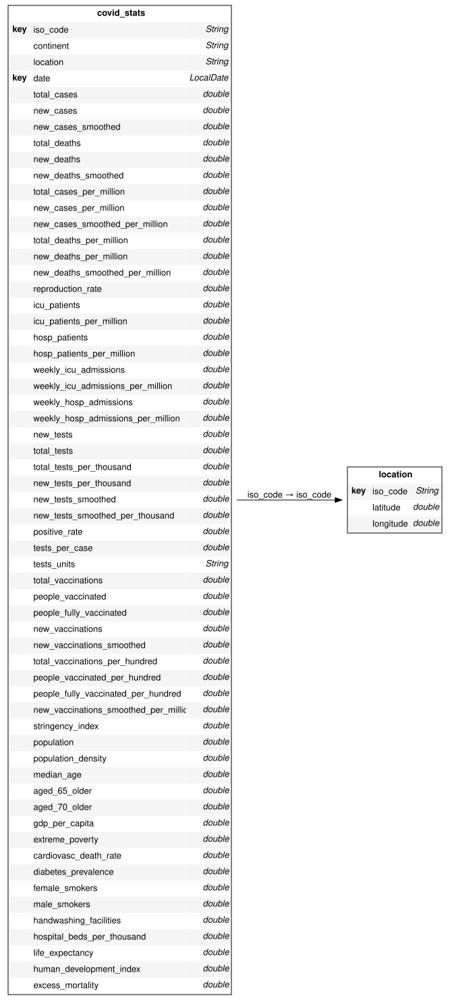

In [39]:
covid_data.join(locations)
cube.schema

In [40]:
cube

In [41]:
m["longtitude"] = tt.agg.mean(locations["longitude"])
m["latitude"] = tt.agg.mean(locations["latitude"])

In [42]:
session.visualize()

Open the notebook in JupyterLab with the Atoti extension enabled to build this widget.

It is pointless to have a longitude and latitude mean at the continent level. We can use the `where` to prevent aggregation at the total level.

In [43]:
m["longtitude"] = tt.where(~l["location"].isnull(), tt.agg.mean(locations["longitude"]))
m["longtitude"].formatter = "DOUBLE[#.#####]"

In [44]:
m["latitude"] = tt.where(~l["location"].isnull(), tt.agg.mean(locations["latitude"]))
m["latitude"].formatter = "DOUBLE[#.#####]"

Longtitude = X-Axis, Latitude = Y-Axis

In [45]:
session.visualize("Total cases per million across the global")

Open the notebook in JupyterLab with the Atoti extension enabled to build this widget.

# Dashboarding

Using `session.link()` we can access the dashboard webapp.  Before we do, let's save some of the widgets we've created and publish them to our the web app.

💡 **Tip**:  When we publish a visual, we're also given a link that will take us to the app.  This is useful to creating a dashboard as you go.

<img src="https://data.atoti.io/notebooks/covid-analytics/img/publish_in_app.gif" width = 70%>

In [46]:
session.link()

Open the notebook in JupyterLab with the Atoti extension enabled to see this link.

💡 __Tip__: We can share a saved dashboard with our peers using its URL. We can print this URL as follows:  

`session.link(path="/#/dashboard/ebb")`  

The last 3 characters are the identifier for the dashboard.

# For more information

### <img src="https://data.atoti.io/notebooks/covid-analytics/img/atoti.png" width = "30px"> Go to https://www.atoti.io to subscribe to our newsletter for the latest information sharing.  




## Follow us on 

### <img src="https://data.atoti.io/notebooks/covid-analytics/img/linkedin.png" width = "20px"> LinkedIn https://www.linkedin.com/company/atoti  
### <img src="https://data.atoti.io/notebooks/covid-analytics/img/twitter.png" width = "20px"> Twitter   https://twitter.com/atoti_io  
### <img src="https://data.atoti.io/notebooks/covid-analytics/img/youtube.png" width = "20px"> YouTube  https://www.youtube.com/c/atoti  
### <img src="https://data.atoti.io/notebooks/covid-analytics/img/medium.png" width = "20px"> Medium   https://medium.com/atoti  



## Reach out to us on  

### <img src="https://data.atoti.io/notebooks/covid-analytics/img/github.png" width = "20px"> GitHub Discussions   https://github.com/atoti/atoti/discussions

<div style="text-align: center;" ><a href="https://www.atoti.io/?utm_source=gallery&utm_content=global-covid-data" target="_blank" rel="noopener noreferrer"><img src="https://data.atoti.io/notebooks/banners/Your-turn-to-try-Atoti.jpg" alt="Try Atoti"></a></div>